# **1. Setup Paths**

In [1]:
import os

In [2]:
CUSTOM_MODEL_NAME = 'my_ssd_mobnet'
PRETRAINED_MODEL_NAME = 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8'
PRETRAINED_MODEL_URL = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz'
TF_RECORD_SCRIPT_NAME = 'generate_tfrecord.py'
LABEL_MAP_NAME = 'label_map.pbtxt'

In [3]:
paths = {
    'WORKSPACE_PATH': os.path.join('Tensorflow', 'workspace'),
    'SCRIPTS_PATH': os.path.join('Tensorflow','scripts'),
    'APIMODEL_PATH': os.path.join('Tensorflow','models'),
    'ANNOTATION_PATH': os.path.join('Tensorflow', 'workspace','annotations'),
    'IMAGE_PATH': os.path.join('Tensorflow', 'workspace','images'),
    'MODEL_PATH': os.path.join('Tensorflow', 'workspace','models'),
    'PRETRAINED_MODEL_PATH': os.path.join('Tensorflow', 'workspace','pre-trained-models'),
    'CHECKPOINT_PATH': os.path.join('Tensorflow', 'workspace','models',CUSTOM_MODEL_NAME), 
    'OUTPUT_PATH': os.path.join('Tensorflow', 'workspace','models',CUSTOM_MODEL_NAME, 'export'), 
    'TFJS_PATH':os.path.join('Tensorflow', 'workspace','models',CUSTOM_MODEL_NAME, 'tfjsexport'), 
    'TFLITE_PATH':os.path.join('Tensorflow', 'workspace','models',CUSTOM_MODEL_NAME, 'tfliteexport'), 
    'PROTOC_PATH':os.path.join('Tensorflow','protoc')
 }

In [4]:
files = {
    'PIPELINE_CONFIG':os.path.join('Tensorflow', 'workspace','models', CUSTOM_MODEL_NAME, 'pipeline.config'),
    'TF_RECORD_SCRIPT': os.path.join(paths['SCRIPTS_PATH'], TF_RECORD_SCRIPT_NAME), 
    'LABELMAP': os.path.join(paths['ANNOTATION_PATH'], LABEL_MAP_NAME)
}

In [5]:
for path in paths.values():
    if not os.path.exists(path):
        if os.name == 'posix':
            !mkdir -p {path}
        if os.name == 'nt':
            !mkdir {path}

# **2. Download the Pretrained Model**

In [6]:
if not os.path.exists(os.path.join(paths['PRETRAINED_MODEL_PATH'], PRETRAINED_MODEL_NAME)):
    if os.name =='posix':
        !wget {PRETRAINED_MODEL_URL}
        !mv {PRETRAINED_MODEL_NAME+'.tar.gz'} {paths['PRETRAINED_MODEL_PATH']}
        !cd {paths['PRETRAINED_MODEL_PATH']} && tar -zxvf {PRETRAINED_MODEL_NAME+'.tar.gz'}
    if os.name == 'nt':
        wget.download(PRETRAINED_MODEL_URL)
        !move {PRETRAINED_MODEL_NAME+'.tar.gz'} {paths['PRETRAINED_MODEL_PATH']}
        !cd {paths['PRETRAINED_MODEL_PATH']} && tar -zxvf {PRETRAINED_MODEL_NAME+'.tar.gz'}

# **3. Create Label Map**

In [7]:
labels = [{'name':'licence', 'id':1}]

if not os.path.exists(files['LABELMAP']):
    with open(files['LABELMAP'], 'w') as f:
        for label in labels:
            f.write('item { \n')
            f.write('\tname:\'{}\'\n'.format(label['name']))
            f.write('\tid:{}\n'.format(label['id']))
            f.write('}\n')

# **4. Create TF records**

In [8]:
if not os.path.exists(files['TF_RECORD_SCRIPT']):
    !git clone https://github.com/nicknochnack/GenerateTFRecord {paths['SCRIPTS_PATH']}

In [9]:
if not os.path.exists(os.path.join(paths['ANNOTATION_PATH'], 'train.record')):
    !python {files['TF_RECORD_SCRIPT']} -x {os.path.join(paths['IMAGE_PATH'], 'train')} -l {files['LABELMAP']} -o {os.path.join(paths['ANNOTATION_PATH'], 'train.record')} 

if not os.path.exists(os.path.join(paths['ANNOTATION_PATH'], 'test.record')):
    !python {files['TF_RECORD_SCRIPT']} -x {os.path.join(paths['IMAGE_PATH'], 'test')} -l {files['LABELMAP']} -o {os.path.join(paths['ANNOTATION_PATH'], 'test.record')} 

# **5. Update Configuration File**

In [10]:
import tensorflow as tf
from object_detection.utils import config_util
from object_detection.protos import pipeline_pb2
from google.protobuf import text_format

In [11]:
if os.name =='posix':
    !cp {os.path.join(paths['PRETRAINED_MODEL_PATH'], PRETRAINED_MODEL_NAME, 'pipeline.config')} {os.path.join(paths['CHECKPOINT_PATH'])}
if os.name == 'nt':
    !copy {os.path.join(paths['PRETRAINED_MODEL_PATH'], PRETRAINED_MODEL_NAME, 'pipeline.config')} {os.path.join(paths['CHECKPOINT_PATH'])}

In [12]:
config = config_util.get_configs_from_pipeline_file(files['PIPELINE_CONFIG'])

In [13]:
config

{'model': ssd {
   num_classes: 90
   image_resizer {
     fixed_shape_resizer {
       height: 320
       width: 320
     }
   }
   feature_extractor {
     type: "ssd_mobilenet_v2_fpn_keras"
     depth_multiplier: 1.0
     min_depth: 16
     conv_hyperparams {
       regularizer {
         l2_regularizer {
           weight: 3.9999998989515007e-05
         }
       }
       initializer {
         random_normal_initializer {
           mean: 0.0
           stddev: 0.009999999776482582
         }
       }
       activation: RELU_6
       batch_norm {
         decay: 0.996999979019165
         scale: true
         epsilon: 0.0010000000474974513
       }
     }
     use_depthwise: true
     override_base_feature_extractor_hyperparams: true
     fpn {
       min_level: 3
       max_level: 7
       additional_layer_depth: 128
     }
   }
   box_coder {
     faster_rcnn_box_coder {
       y_scale: 10.0
       x_scale: 10.0
       height_scale: 5.0
       width_scale: 5.0
     }
   }
   matc

In [14]:
pipeline_config = pipeline_pb2.TrainEvalPipelineConfig()
with tf.io.gfile.GFile(files['PIPELINE_CONFIG'], "r") as f:                                                                                                                                                                                                                     
    proto_str = f.read()                                                                                                                                                                                                                                          
    text_format.Merge(proto_str, pipeline_config)  

In [15]:
pipeline_config.model.ssd.num_classes = len(labels)
pipeline_config.train_config.batch_size = 4
pipeline_config.train_config.fine_tune_checkpoint = os.path.join(paths['PRETRAINED_MODEL_PATH'], PRETRAINED_MODEL_NAME, 'checkpoint', 'ckpt-0')
pipeline_config.train_config.fine_tune_checkpoint_type = "detection"
pipeline_config.train_input_reader.label_map_path= files['LABELMAP']
pipeline_config.train_input_reader.tf_record_input_reader.input_path[:] = [os.path.join(paths['ANNOTATION_PATH'], 'train.record')]
pipeline_config.eval_input_reader[0].label_map_path = files['LABELMAP']
pipeline_config.eval_input_reader[0].tf_record_input_reader.input_path[:] = [os.path.join(paths['ANNOTATION_PATH'], 'test.record')]

In [16]:
config_text = text_format.MessageToString(pipeline_config)                                                                                                                                                                                                        
with tf.io.gfile.GFile(files['PIPELINE_CONFIG'], "wb") as f:                                                                                                                                                                                                                     
    f.write(config_text)   

# **6. Model Training**

In [17]:
TRAINING_SCRIPT = os.path.join(paths['APIMODEL_PATH'], 'research', 'object_detection', 'model_main_tf2.py')

In [18]:
command = "python {} --model_dir={} --pipeline_config_path={} --num_train_steps=10000".format(TRAINING_SCRIPT, paths['CHECKPOINT_PATH'],files['PIPELINE_CONFIG'])

In [19]:
print(command)

python Tensorflow/models/research/object_detection/model_main_tf2.py --model_dir=Tensorflow/workspace/models/my_ssd_mobnet --pipeline_config_path=Tensorflow/workspace/models/my_ssd_mobnet/pipeline.config --num_train_steps=10000


In [20]:
!{command}

2022-08-16 03:53:42.174547: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2022-08-16 03:53:42.174587: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (LaurenSafwat): /proc/driver/nvidia/version does not exist
2022-08-16 03:53:42.175150: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
W0816 03:53:42.176469 139979712149312 cross_device_ops.py:1386] There are non-GPU devices in `tf.distribute.Strategy`, not using nccl allreduce.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:CPU:0',)
I0816 03:53:42.181992 139979712149312 mirrored

INFO:tensorflow:Step 100 per-step time 2.092s
I0816 03:58:03.735425 139979712149312 model_lib_v2.py:705] Step 100 per-step time 2.092s
INFO:tensorflow:{'Loss/classification_loss': 0.5240835,
 'Loss/localization_loss': 0.468922,
 'Loss/regularization_loss': 0.15464118,
 'Loss/total_loss': 1.1476467,
 'learning_rate': 0.0319994}
I0816 03:58:03.736353 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss': 0.5240835,
 'Loss/localization_loss': 0.468922,
 'Loss/regularization_loss': 0.15464118,
 'Loss/total_loss': 1.1476467,
 'learning_rate': 0.0319994}
INFO:tensorflow:Step 200 per-step time 1.403s
I0816 04:00:24.016956 139979712149312 model_lib_v2.py:705] Step 200 per-step time 1.403s
INFO:tensorflow:{'Loss/classification_loss': 0.2536188,
 'Loss/localization_loss': 0.39592344,
 'Loss/regularization_loss': 0.15475123,
 'Loss/total_loss': 0.80429345,
 'learning_rate': 0.0373328}
I0816 04:00:24.017227 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss': 0.2536188,
 'L

INFO:tensorflow:Step 1600 per-step time 1.309s
I0816 04:32:43.239514 139979712149312 model_lib_v2.py:705] Step 1600 per-step time 1.309s
INFO:tensorflow:{'Loss/classification_loss': 0.16856192,
 'Loss/localization_loss': 0.1421358,
 'Loss/regularization_loss': 0.15475303,
 'Loss/total_loss': 0.46545076,
 'learning_rate': 0.079970405}
I0816 04:32:43.239872 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss': 0.16856192,
 'Loss/localization_loss': 0.1421358,
 'Loss/regularization_loss': 0.15475303,
 'Loss/total_loss': 0.46545076,
 'learning_rate': 0.079970405}
INFO:tensorflow:Step 1700 per-step time 1.306s
I0816 04:34:53.863606 139979712149312 model_lib_v2.py:705] Step 1700 per-step time 1.306s
INFO:tensorflow:{'Loss/classification_loss': 0.12213515,
 'Loss/localization_loss': 0.090591274,
 'Loss/regularization_loss': 0.15415385,
 'Loss/total_loss': 0.36688027,
 'learning_rate': 0.07995972}
I0816 04:34:53.863953 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss

INFO:tensorflow:Step 3100 per-step time 1.379s
I0816 05:06:47.052570 139979712149312 model_lib_v2.py:705] Step 3100 per-step time 1.379s
INFO:tensorflow:{'Loss/classification_loss': 0.13059367,
 'Loss/localization_loss': 0.1659285,
 'Loss/regularization_loss': 0.1482854,
 'Loss/total_loss': 0.4448076,
 'learning_rate': 0.07963799}
I0816 05:06:47.052914 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss': 0.13059367,
 'Loss/localization_loss': 0.1659285,
 'Loss/regularization_loss': 0.1482854,
 'Loss/total_loss': 0.4448076,
 'learning_rate': 0.07963799}
INFO:tensorflow:Step 3200 per-step time 1.363s
I0816 05:09:03.345239 139979712149312 model_lib_v2.py:705] Step 3200 per-step time 1.363s
INFO:tensorflow:{'Loss/classification_loss': 0.1278569,
 'Loss/localization_loss': 0.075149395,
 'Loss/regularization_loss': 0.1478402,
 'Loss/total_loss': 0.3508465,
 'learning_rate': 0.07960275}
I0816 05:09:03.345494 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss': 0.1278

INFO:tensorflow:Step 4600 per-step time 1.145s
I0816 05:42:01.172560 139979712149312 model_lib_v2.py:705] Step 4600 per-step time 1.145s
INFO:tensorflow:{'Loss/classification_loss': 0.11645669,
 'Loss/localization_loss': 0.099087715,
 'Loss/regularization_loss': 0.14113738,
 'Loss/total_loss': 0.35668176,
 'learning_rate': 0.078939244}
I0816 05:42:01.172817 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss': 0.11645669,
 'Loss/localization_loss': 0.099087715,
 'Loss/regularization_loss': 0.14113738,
 'Loss/total_loss': 0.35668176,
 'learning_rate': 0.078939244}
INFO:tensorflow:Step 4700 per-step time 1.138s
I0816 05:43:54.988468 139979712149312 model_lib_v2.py:705] Step 4700 per-step time 1.138s
INFO:tensorflow:{'Loss/classification_loss': 0.07489766,
 'Loss/localization_loss': 0.04511016,
 'Loss/regularization_loss': 0.14050204,
 'Loss/total_loss': 0.26050985,
 'learning_rate': 0.07887978}
I0816 05:43:54.988715 139979712149312 model_lib_v2.py:708] {'Loss/classification_l

INFO:tensorflow:Step 6100 per-step time 1.102s
I0816 06:09:55.514030 139979712149312 model_lib_v2.py:705] Step 6100 per-step time 1.102s
INFO:tensorflow:{'Loss/classification_loss': 0.10921759,
 'Loss/localization_loss': 0.0953706,
 'Loss/regularization_loss': 0.13381408,
 'Loss/total_loss': 0.33840227,
 'learning_rate': 0.077880636}
I0816 06:09:55.514348 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss': 0.10921759,
 'Loss/localization_loss': 0.0953706,
 'Loss/regularization_loss': 0.13381408,
 'Loss/total_loss': 0.33840227,
 'learning_rate': 0.077880636}
INFO:tensorflow:Step 6200 per-step time 1.106s
I0816 06:11:46.098237 139979712149312 model_lib_v2.py:705] Step 6200 per-step time 1.106s
INFO:tensorflow:{'Loss/classification_loss': 0.07584387,
 'Loss/localization_loss': 0.05588215,
 'Loss/regularization_loss': 0.13324513,
 'Loss/total_loss': 0.26497114,
 'learning_rate': 0.07779749}
I0816 06:11:46.098530 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss'

INFO:tensorflow:Step 7600 per-step time 1.104s
I0816 06:37:39.763845 139979712149312 model_lib_v2.py:705] Step 7600 per-step time 1.104s
INFO:tensorflow:{'Loss/classification_loss': 0.09864722,
 'Loss/localization_loss': 0.10554323,
 'Loss/regularization_loss': 0.1263406,
 'Loss/total_loss': 0.33053106,
 'learning_rate': 0.07647194}
I0816 06:37:39.764168 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss': 0.09864722,
 'Loss/localization_loss': 0.10554323,
 'Loss/regularization_loss': 0.1263406,
 'Loss/total_loss': 0.33053106,
 'learning_rate': 0.07647194}
INFO:tensorflow:Step 7700 per-step time 1.098s
I0816 06:39:29.557452 139979712149312 model_lib_v2.py:705] Step 7700 per-step time 1.098s
INFO:tensorflow:{'Loss/classification_loss': 0.10749168,
 'Loss/localization_loss': 0.09422665,
 'Loss/regularization_loss': 0.12577772,
 'Loss/total_loss': 0.32749605,
 'learning_rate': 0.07636588}
I0816 06:39:29.557770 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss': 

INFO:tensorflow:Step 9100 per-step time 1.098s
I0816 07:05:15.807145 139979712149312 model_lib_v2.py:705] Step 9100 per-step time 1.098s
INFO:tensorflow:{'Loss/classification_loss': 0.12228579,
 'Loss/localization_loss': 0.0693319,
 'Loss/regularization_loss': 0.119492054,
 'Loss/total_loss': 0.31110972,
 'learning_rate': 0.07472619}
I0816 07:05:15.807471 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss': 0.12228579,
 'Loss/localization_loss': 0.0693319,
 'Loss/regularization_loss': 0.119492054,
 'Loss/total_loss': 0.31110972,
 'learning_rate': 0.07472619}
INFO:tensorflow:Step 9200 per-step time 1.101s
I0816 07:07:05.930850 139979712149312 model_lib_v2.py:705] Step 9200 per-step time 1.101s
INFO:tensorflow:{'Loss/classification_loss': 0.07687998,
 'Loss/localization_loss': 0.09142369,
 'Loss/regularization_loss': 0.11900008,
 'Loss/total_loss': 0.28730375,
 'learning_rate': 0.07459819}
I0816 07:07:05.931108 139979712149312 model_lib_v2.py:708] {'Loss/classification_loss'

# **7. Model Evaluation**

In [21]:
command = "python {} --model_dir={} --pipeline_config_path={} --checkpoint_dir={}".format(TRAINING_SCRIPT, paths['CHECKPOINT_PATH'],files['PIPELINE_CONFIG'], paths['CHECKPOINT_PATH'])

In [22]:
print(command)

python Tensorflow/models/research/object_detection/model_main_tf2.py --model_dir=Tensorflow/workspace/models/my_ssd_mobnet --pipeline_config_path=Tensorflow/workspace/models/my_ssd_mobnet/pipeline.config --checkpoint_dir=Tensorflow/workspace/models/my_ssd_mobnet


In [23]:
!{command}

2022-08-16 07:22:15.964555: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2022-08-16 07:22:15.964680: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (LaurenSafwat): /proc/driver/nvidia/version does not exist
W0816 07:22:15.976763 140519183628096 model_lib_v2.py:1089] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0816 07:22:15.977212 140519183628096 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0816 07:22:15.977474 140519183628096 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0816 07:22:15.977729 140519183628096 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0816 07:22:15.978079 140519183628096 mod

INFO:tensorflow:Performing evaluation on 60 images.
I0816 07:22:55.582286 140519183628096 coco_evaluation.py:293] Performing evaluation on 60 images.
creating index...
index created!
INFO:tensorflow:Loading and preparing annotation results...
I0816 07:22:55.583265 140519183628096 coco_tools.py:116] Loading and preparing annotation results...
INFO:tensorflow:DONE (t=0.00s)
I0816 07:22:55.587205 140519183628096 coco_tools.py:138] DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.34s).
Accumulating evaluation results...
DONE (t=0.06s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.517
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.915
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.472
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.400
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100

# **8. Model Testing**

## **8.1. Loading the trained model from the latest checkpoint**

In [24]:
import os
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder
from object_detection.utils import config_util

In [25]:
# Load pipeline config and build a detection model
configs = config_util.get_configs_from_pipeline_file(files['PIPELINE_CONFIG'])
detection_model = model_builder.build(model_config=configs['model'], is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(model=detection_model)
ckpt.restore(os.path.join(paths['CHECKPOINT_PATH'], 'ckpt-11')).expect_partial()

@tf.function
def detect_fn(image):
    image, shapes = detection_model.preprocess(image)
    prediction_dict = detection_model.predict(image, shapes)
    detections = detection_model.postprocess(prediction_dict, shapes)
    return detections

2022-08-16 08:27:33.751230: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2022-08-16 08:27:33.752936: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (LaurenSafwat): /proc/driver/nvidia/version does not exist
2022-08-16 08:27:33.762330: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


## **8.2. Image Detection**

In [26]:
import cv2 
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

In [27]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)

In [28]:
category_index = label_map_util.create_category_index_from_labelmap(files['LABELMAP'])

In [67]:
import glob

IMAGE_PATHS = glob.glob(os.path.join(paths['IMAGE_PATH'], 'test', '*.png'))

In [68]:
RESULTS_PATH = os.path.join(paths['IMAGE_PATH'], 'detections')

if not os.path.exists(RESULTS_PATH):
    !mkdir {RESULTS_PATH}

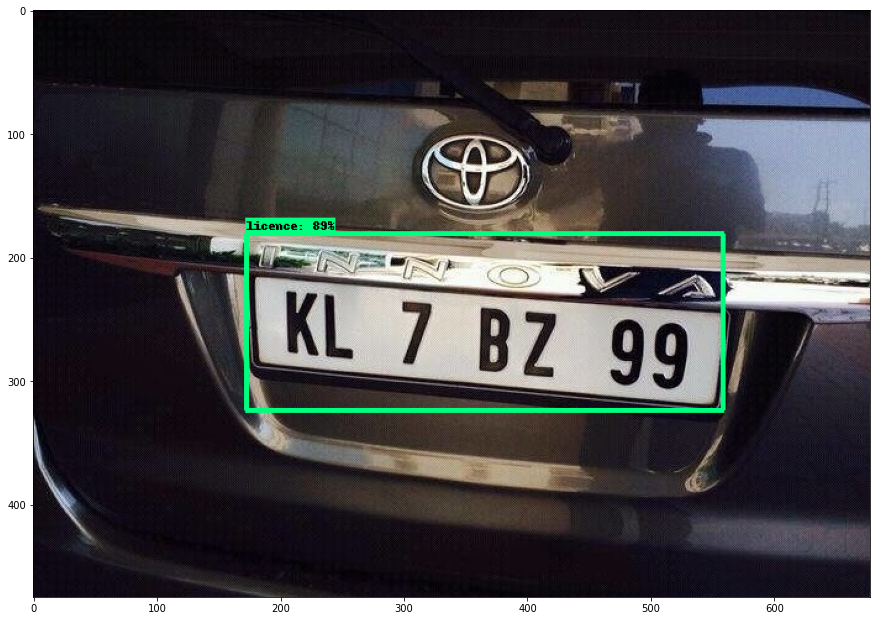

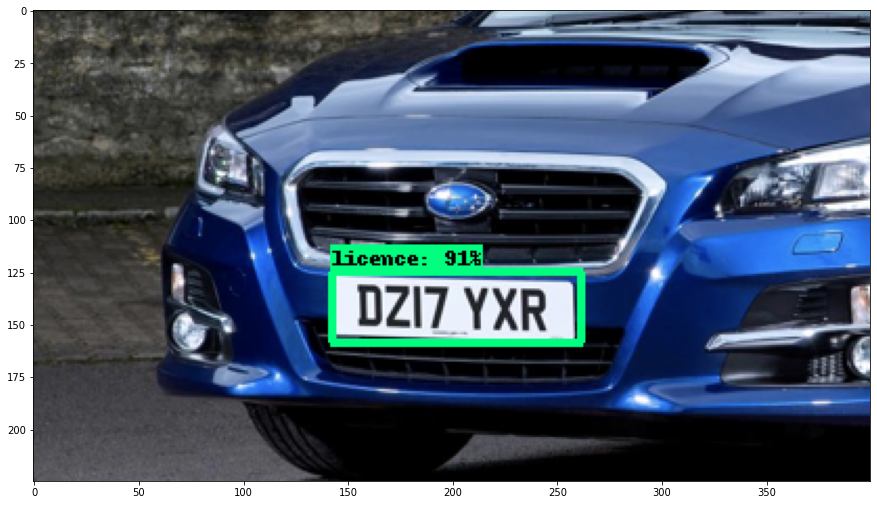

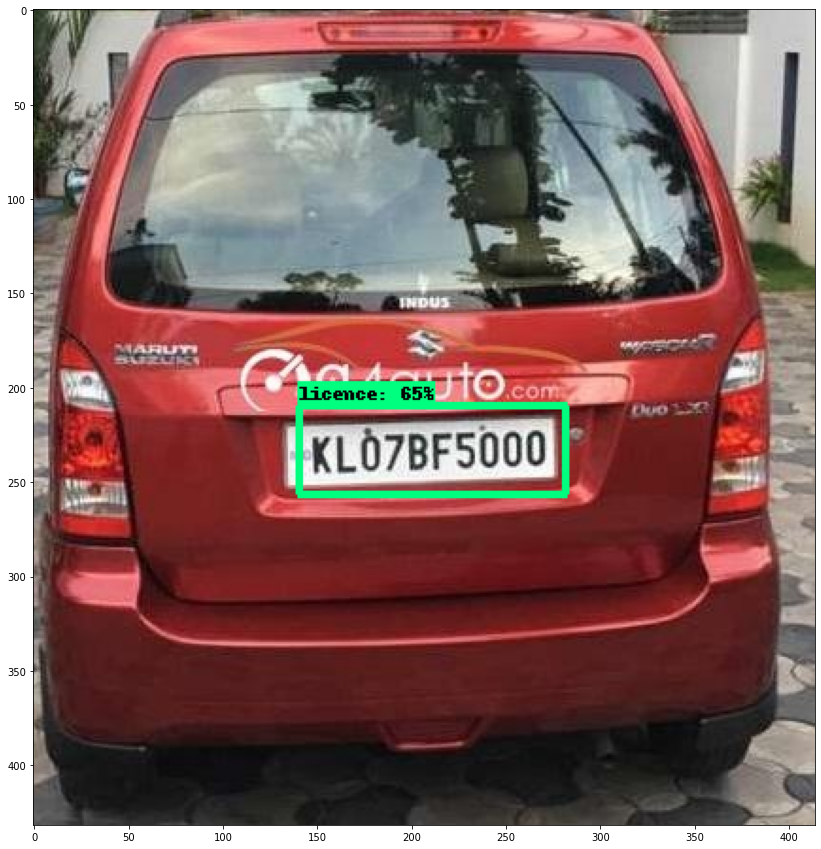

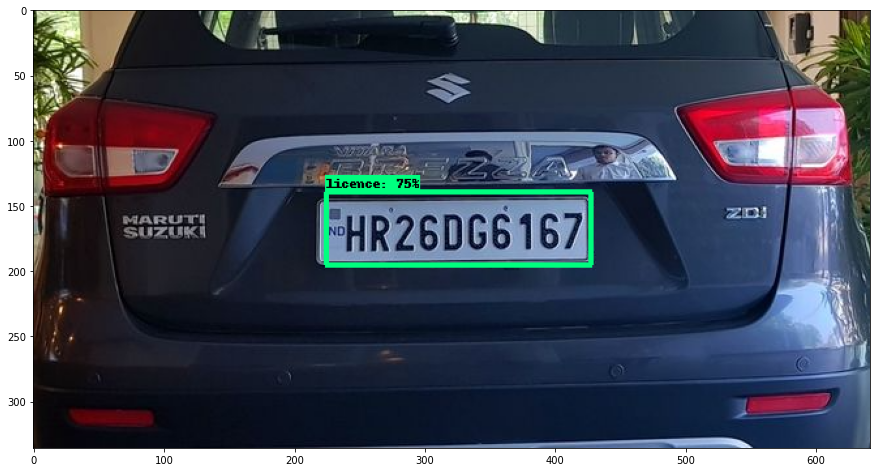

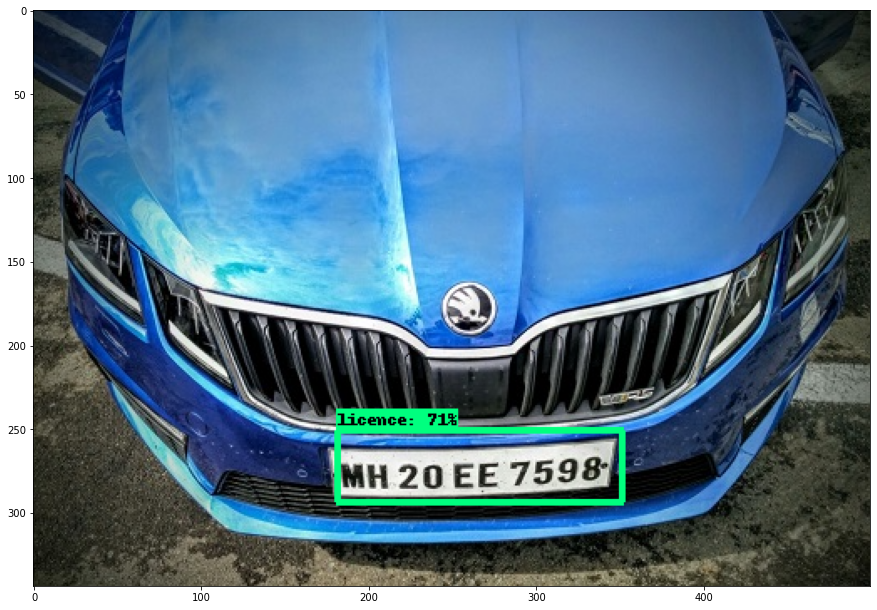

...

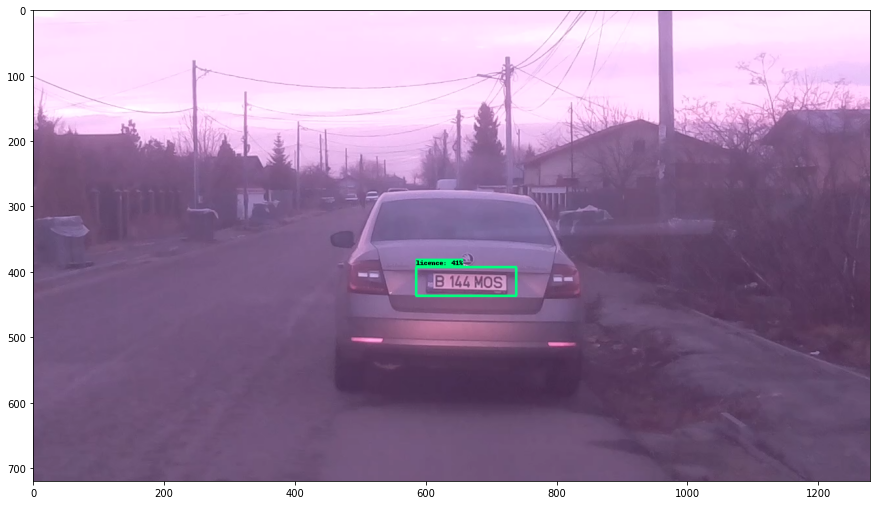

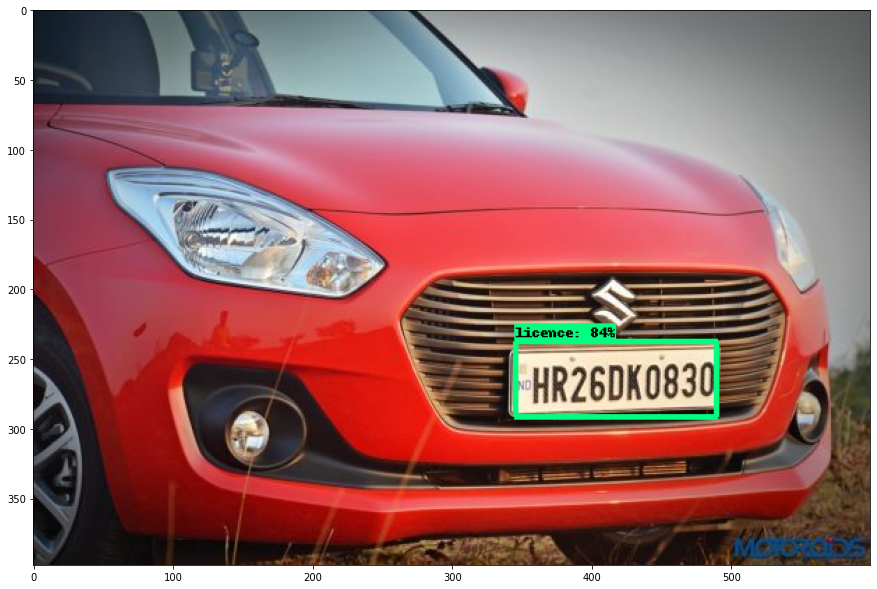

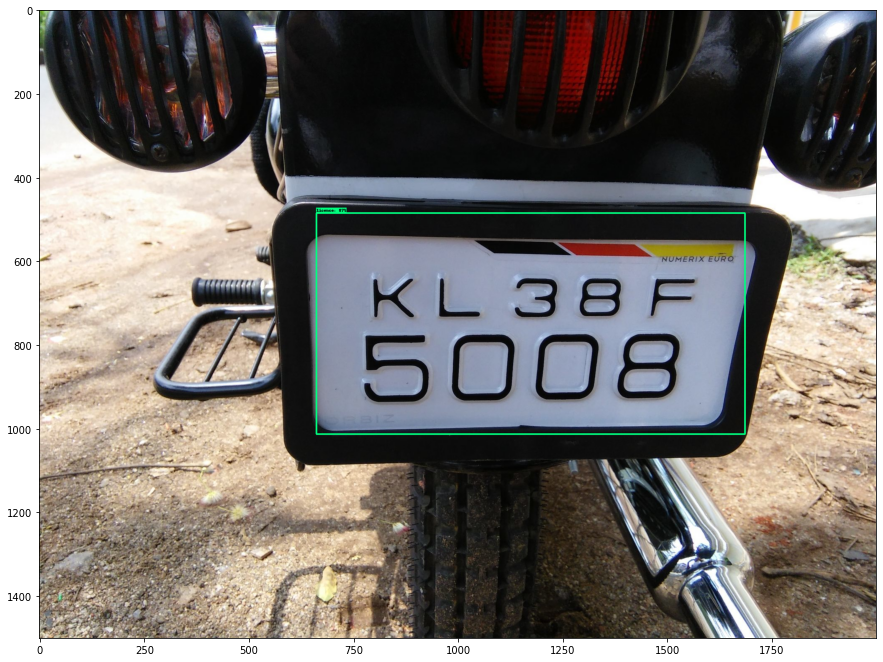

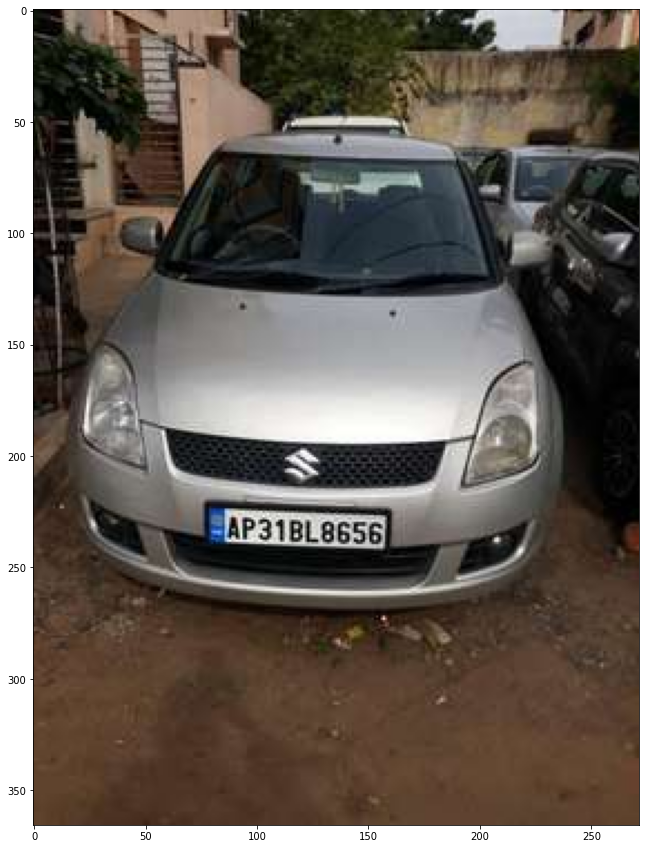

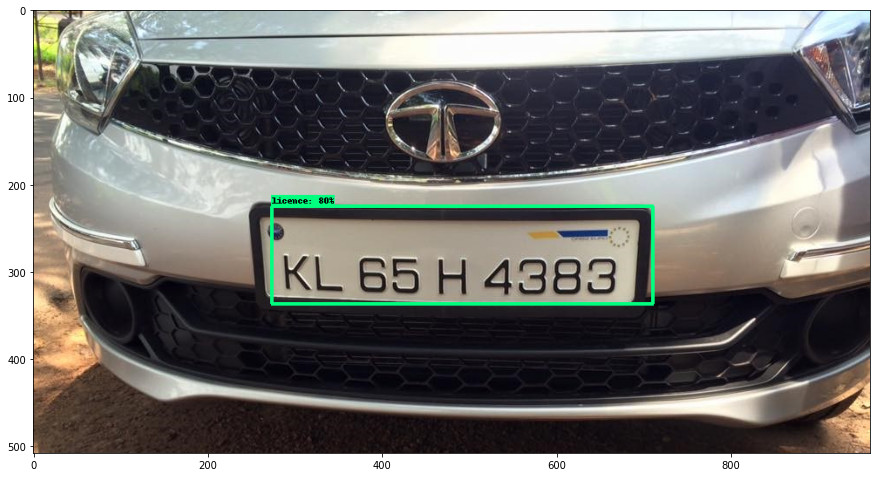

In [71]:
for IMAGE_PATH in IMAGE_PATHS:
    img = cv2.imread(IMAGE_PATH)
    image_np = np.array(img)

    input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
    detections = detect_fn(input_tensor)

    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                  for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    label_id_offset = 1
    image_np_with_detections = image_np.copy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
                image_np_with_detections,
                detections['detection_boxes'],
                detections['detection_classes']+label_id_offset,
                detections['detection_scores'],
                category_index,
                use_normalized_coordinates=True,
                max_boxes_to_draw=5,
                min_score_thresh=.3,
                agnostic_mode=False)

    image_np_with_detections = cv2.cvtColor(image_np_with_detections, cv2.COLOR_BGR2RGB)
    cv2.imwrite(IMAGE_PATH.replace('test', 'detections'), image_np_with_detections)
    
    plt.figure(figsize=(15, 15))
    plt.imshow(image_np_with_detections)
    plt.show()
    

## **8.3. Real Time Detections from a Webcam**

In [18]:
!pip uninstall opencv-python-headless -y

In [14]:
cap = cv2.VideoCapture(0)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

while cap.isOpened(): 
    ret, frame = cap.read()
    image_np = np.array(frame)
    
    input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
    detections = detect_fn(input_tensor)
    
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                  for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    label_id_offset = 1
    image_np_with_detections = image_np.copy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
                image_np_with_detections,
                detections['detection_boxes'],
                detections['detection_classes']+label_id_offset,
                detections['detection_scores'],
                category_index,
                use_normalized_coordinates=True,
                max_boxes_to_draw=5,
                min_score_thresh=.8,
                agnostic_mode=False)

    cv2.imshow('object detection',  cv2.resize(image_np_with_detections, (800, 600)))
    
    if cv2.waitKey(10) & 0xFF == ord('q'):
        cap.release()
        cv2.destroyAllWindows()
        break

# **9. Freezing the Graph**

In [32]:
FREEZE_SCRIPT = os.path.join(paths['APIMODEL_PATH'], 'research', 'object_detection', 'exporter_main_v2.py ')

In [33]:
command = "python {} --input_type=image_tensor --pipeline_config_path={} --trained_checkpoint_dir={} --output_directory={}".format(FREEZE_SCRIPT ,files['PIPELINE_CONFIG'], paths['CHECKPOINT_PATH'], paths['OUTPUT_PATH'])

In [34]:
!{command}

2022-08-16 08:27:41.530386: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2022-08-16 08:27:41.530429: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (LaurenSafwat): /proc/driver/nvidia/version does not exist
2022-08-16 08:27:41.536023: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0816 08:27:41.789491 139680669652800 deprecation.py:623]

W0816 08:28:23.915180 139680669652800 save.py:233] Found untraced functions such as WeightSharedConvolutionalBoxPredictor_layer_call_fn, WeightSharedConvolutionalBoxPredictor_layer_call_and_return_conditional_losses, WeightSharedConvolutionalBoxHead_layer_call_fn, WeightSharedConvolutionalBoxHead_layer_call_and_return_conditional_losses, WeightSharedConvolutionalClassHead_layer_call_fn while saving (showing 5 of 173). These functions will not be directly callable after loading.
INFO:tensorflow:Assets written to: Tensorflow/workspace/models/my_ssd_mobnet/export/saved_model/assets
I0816 08:28:30.195257 139680669652800 builder_impl.py:779] Assets written to: Tensorflow/workspace/models/my_ssd_mobnet/export/saved_model/assets
INFO:tensorflow:Writing pipeline config file to Tensorflow/workspace/models/my_ssd_mobnet/export/pipeline.config
I0816 08:28:30.924533 139680669652800 config_util.py:253] Writing pipeline config file to Tensorflow/workspace/models/my_ssd_mobnet/export/pipeline.config


# **10. Conversion to TFJS**

In [35]:
!pip install tensorflowjs

In [36]:
command = "tensorflowjs_converter --input_format=tf_saved_model --output_node_names='detection_boxes,detection_classes,detection_features,detection_multiclass_scores,detection_scores,num_detections,raw_detection_boxes,raw_detection_scores' --output_format=tfjs_graph_model --signature_name=serving_default {} {}".format(os.path.join(paths['OUTPUT_PATH'], 'saved_model'), paths['TFJS_PATH'])

In [37]:
!{command}

2022-08-16 08:28:38.554220: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2022-08-16 08:28:38.554261: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (LaurenSafwat): /proc/driver/nvidia/version does not exist
2022-08-16 08:28:38.554628: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-08-16 08:28:49.482604: I tensorflow/core/grappler/devices.cc:66] Number of eligible GPUs (core count >= 8, compute capability >= 0.0): 0
2022-08-16 08:28:49.482866: I tensorflow/core/grappler/clusters/single_machine.cc:358] Starting new session
Writing weight file Tensorflow/workspace/mo

# **11. Conversion to TFLite**

In [38]:
TFLITE_SCRIPT = os.path.join(paths['APIMODEL_PATH'], 'research', 'object_detection', 'export_tflite_graph_tf2.py ')

In [39]:
command = "python {} --pipeline_config_path={} --trained_checkpoint_dir={} --output_directory={}".format(TFLITE_SCRIPT ,files['PIPELINE_CONFIG'], paths['CHECKPOINT_PATH'], paths['TFLITE_PATH'])

In [40]:
!{command}

2022-08-16 08:29:09.878483: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2022-08-16 08:29:09.878520: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (LaurenSafwat): /proc/driver/nvidia/version does not exist
2022-08-16 08:29:09.884745: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-08-16 08:29:17.400469: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:354] MLIR V1 optimization pass is not enabled
W0816 08:29:23.024954 139831542740800 save_impl.py:71] Skipping full serialization of Keras layer <object_detection.meta_architectures.ssd_meta_arch.SSDMetaArch

W0816 08:29:44.218225 139831542740800 save.py:233] Found untraced functions such as WeightSharedConvolutionalBoxPredictor_layer_call_fn, WeightSharedConvolutionalBoxPredictor_layer_call_and_return_conditional_losses, WeightSharedConvolutionalBoxHead_layer_call_fn, WeightSharedConvolutionalBoxHead_layer_call_and_return_conditional_losses, WeightSharedConvolutionalClassHead_layer_call_fn while saving (showing 5 of 173). These functions will not be directly callable after loading.
INFO:tensorflow:Assets written to: Tensorflow/workspace/models/my_ssd_mobnet/tfliteexport/saved_model/assets
I0816 08:29:50.256230 139831542740800 builder_impl.py:779] Assets written to: Tensorflow/workspace/models/my_ssd_mobnet/tfliteexport/saved_model/assets


In [41]:
FROZEN_TFLITE_PATH = os.path.join(paths['TFLITE_PATH'], 'saved_model')
TFLITE_MODEL = os.path.join(paths['TFLITE_PATH'], 'saved_model', 'detect.tflite')

In [42]:
command = "tflite_convert \
--saved_model_dir={} \
--output_file={} \
--input_shapes=1,300,300,3 \
--input_arrays=normalized_input_image_tensor \
--output_arrays='TFLite_Detection_PostProcess','TFLite_Detection_PostProcess:1','TFLite_Detection_PostProcess:2','TFLite_Detection_PostProcess:3' \
--inference_type=FLOAT \
--allow_custom_ops".format(FROZEN_TFLITE_PATH, TFLITE_MODEL, )

In [43]:
!{command}

2022-08-16 08:29:55.338369: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
2022-08-16 08:29:55.338406: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (LaurenSafwat): /proc/driver/nvidia/version does not exist
2022-08-16 08:29:55.879945: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-08-16 08:30:07.914213: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:362] Ignored output_format.
2022-08-16 08:30:07.914259: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:365] Ignored drop_control_dependency.
2022-08-16 08:30:07.915454: I tenso

# **12. Zip and Export Models**

In [44]:
!tar -czf models.tar.gz {paths['CHECKPOINT_PATH']}